In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# Import Libraries

In [2]:
# Importing Libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True) 
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import RepeatedKFold
import xgboost as xgb
import lightgbm
from catboost import CatBoostRegressor
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error

# Import the Dataset

In [21]:
# Importing Dataset

train_data = pd.read_csv(r'C:\Users\Emincan\Desktop\Playground\train.csv') # Importing training data
test_data = pd.read_csv(r'C:\Users\Emincan\Desktop\Playground\test.csv') # Importing test data
# original_data = pd.read_csv('C:\Users\Emincan\Desktop\Playground\original.csv') # Importing original data

sub = pd.read_csv(r'C:\Users\Emincan\Desktop\Playground\sample_submission.csv') # Importing test data

# Displaying Data Shape
print(f"Training Data shape :{train_data.shape}")
print(f"Test Data shape :{test_data.shape}")

Training Data shape :(74051, 10)
Test Data shape :(49368, 9)


# Data Profiling

1) Data Summary
2) Missing Values
3) Outliers
4) Zero/ Non Zero Values

In [5]:
# Understanding the summary statistics of the data

def data_summary(df):
    # Summary statistics
    summary_stats = df.describe()

    # Count of missing values
    missing_values = df.isnull().sum()

    # Count of outliers
    outliers = {}
    for col in df.columns:
        if df[col].dtype != 'object':
            q1 = df[col].quantile(0.25)
            q3 = df[col].quantile(0.75)
            iqr = q3 - q1
            lower_bound = q1 - 1.5 * iqr
            upper_bound = q3 + 1.5 * iqr
            num_outliers = len(df[(df[col] < lower_bound) | (df[col] > upper_bound)])
            outliers[col] = num_outliers

    # Other measures
    measures = {}
    for col in df.columns:
        if df[col].dtype != 'object':
            unique_values = df[col].nunique()
            zero_values = len(df[df[col] == 0])
            measures[col] = {'Unique Values': unique_values, 'Zero Values': zero_values}
            
    combined_table = pd.DataFrame(pd.concat([summary_stats.T, pd.Series(missing_values, name='Missing'), pd.Series(outliers, name='Outliers')], axis=1))

    return combined_table, measures

In [6]:
# Analysising the training data

stats_train, measures_train = data_summary(train_data)
display(stats_train, measures_train)

,count,mean,std,min,25%,50%,75%,max,Missing,Outliers
id,74051.0,37025.000000,21376.826729,0.000000,18512.500000,37025.000000,55537.500000,74050.000000,0,0.0
Length,74051.0,1.317460,0.287757,0.187500,1.150000,1.375000,1.537500,2.012815,0,1270.0
Diameter,74051.0,1.024496,0.237396,0.137500,0.887500,1.075000,1.200000,1.612500,0,1278.0
Height,74051.0,0.348089,0.092034,0.000000,0.300000,0.362500,0.412500,2.825000,0,1250.0
Weight,74051.0,23.385217,12.648153,0.056699,13.437663,23.799405,32.162508,80.101512,0,249.0
Shucked Weight,74051.0,10.104270,5.618025,0.028349,5.712424,9.908150,14.033003,42.184056,0,311.0
Viscera Weight,74051.0,5.058386,2.792729,0.042524,2.863300,4.989512,6.988152,21.545620,0,283.0
Shell Weight,74051.0,6.723870,3.584372,0.042524,3.968930,6.931453,9.071840,28.491248,0,397.0
Age,74051.0,9.967806,3.175189,1.000000,8.000000,10.000000,11.000000,29.000000,0,4811.0
Sex,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN


{'id': {'Unique Values': 74051, 'Zero Values': 1},
 'Length': {'Unique Values': 144, 'Zero Values': 0},
 'Diameter': {'Unique Values': 122, 'Zero Values': 0},
 'Height': {'Unique Values': 65, 'Zero Values': 24},
 'Weight': {'Unique Values': 3096, 'Zero Values': 0},
 'Shucked Weight': {'Unique Values': 1766, 'Zero Values': 0},
 'Viscera Weight': {'Unique Values': 967, 'Zero Values': 0},
 'Shell Weight': {'Unique Values': 1048, 'Zero Values': 0},
 'Age': {'Unique Values': 28, 'Zero Values': 0}}

In [7]:
# Analysising the test data

stats_test, measures_test = data_summary(test_data)
display(stats_test, measures_test)

,count,mean,std,min,25%,50%,75%,max,Missing,Outliers
id,49368.0,98734.500000,14251.458382,74051.000000,86392.750000,98734.500000,111076.250000,123418.000000,0,0.0
Length,49368.0,1.319795,0.286950,0.187500,1.162500,1.387500,1.537500,2.037500,0,1067.0
Diameter,49368.0,1.026357,0.236593,0.137500,0.887500,1.075000,1.200000,1.625000,0,855.0
Height,49368.0,0.348693,0.092259,0.000000,0.300000,0.362500,0.412500,2.825000,0,830.0
Weight,49368.0,23.464627,12.641703,0.056699,13.536886,23.813580,32.290081,80.101512,0,172.0
Shucked Weight,49368.0,10.130220,5.611779,0.028349,5.740774,9.979024,14.047177,42.184056,0,213.0
Viscera Weight,49368.0,5.072615,2.791563,0.014175,2.877474,4.989512,7.016501,21.545620,0,184.0
Shell Weight,49368.0,6.745876,3.575650,0.042524,3.968930,6.945627,9.171063,28.491248,0,251.0
Sex,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN


{'id': {'Unique Values': 49368, 'Zero Values': 0},
 'Length': {'Unique Values': 140, 'Zero Values': 0},
 'Diameter': {'Unique Values': 122, 'Zero Values': 0},
 'Height': {'Unique Values': 57, 'Zero Values': 14},
 'Weight': {'Unique Values': 2948, 'Zero Values': 0},
 'Shucked Weight': {'Unique Values': 1692, 'Zero Values': 0},
 'Viscera Weight': {'Unique Values': 938, 'Zero Values': 0},
 'Shell Weight': {'Unique Values': 987, 'Zero Values': 0}}

# Data Visualisation

1) Univariate Analysis
* Pie Chart
* Box Plots

In [8]:
values = train_data["Sex"].value_counts()
labels = ["M", "I", "F"]
fig = px.pie(train_data, values=values, names=labels, title="Distribution of Sex")
fig.show()

KeyError: 'count'

In [9]:
values = test_data["Sex"].value_counts()
labels = ["M", "I", "F"]
fig = px.pie(test_data, values=values, names=labels, title="Distribution of Sex")
fig.show()

KeyError: 'count'

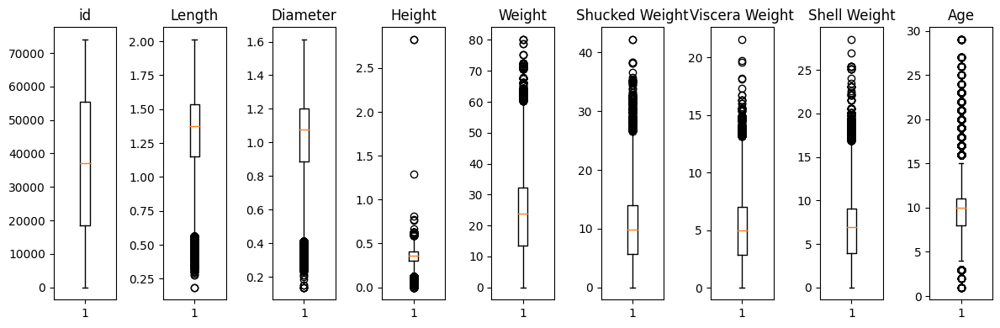

In [10]:
numeric_columns = train_data.select_dtypes(include='number')

# Determine the number of numeric columns
num_columns = numeric_columns.shape[1]

# Create subplots for each numeric column
fig, axs = plt.subplots(1, num_columns, figsize=(12, 4))

# Plot boxplots for each numeric column
for i, column in enumerate(numeric_columns):
    axs[i].boxplot(numeric_columns[column])
    axs[i].set_title(column)

# Adjust spacing between subplots
plt.tight_layout()

# Display the plot
plt.show()

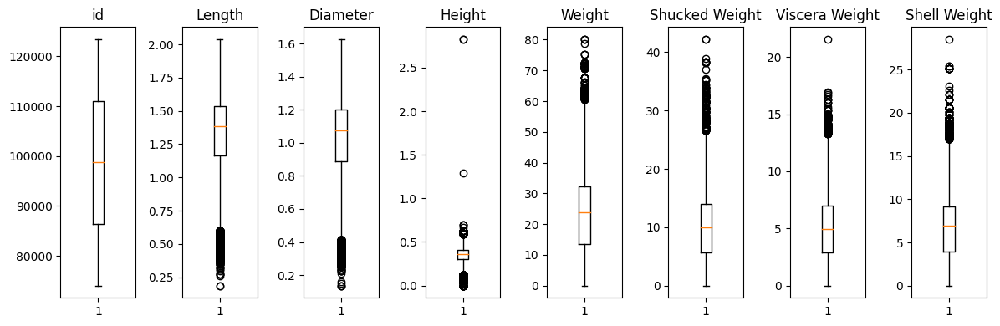

In [11]:
numeric_columns = test_data.select_dtypes(include='number')

# Determine the number of numeric columns
num_columns = numeric_columns.shape[1]

# Create subplots for each numeric column
fig, axs = plt.subplots(1, num_columns, figsize=(12, 4))

# Plot boxplots for each numeric column
for i, column in enumerate(numeric_columns):
    axs[i].boxplot(numeric_columns[column])
    axs[i].set_title(column)

# Adjust spacing between subplots
plt.tight_layout()

# Display the plot
plt.show()

2) Bivariate Analysis
* Pairplots

In [12]:
# Pairplot on Train Data

fig = px.scatter_matrix(train_data.drop('id',axis=1),
                        dimensions=['Length', 'Diameter', 'Height', 'Weight', 'Shucked Weight',
                                    'Viscera Weight', 'Shell Weight', 'Age'],
                        color='Sex')
fig.update_layout(title='Pairplot on Training Data', width=1500, height=1200)
fig.show()

In [13]:
# Pairplot on Test Data

fig = px.scatter_matrix(test_data.drop('id',axis=1),
                        dimensions=['Length', 'Diameter', 'Height', 'Weight', 'Shucked Weight',
                                    'Viscera Weight', 'Shell Weight'],
                        color='Sex')
fig.update_layout(title='Pairplot on Test Data', width=1500, height=1200)
fig.show()

3) Correlation Analysis

<Axes: >

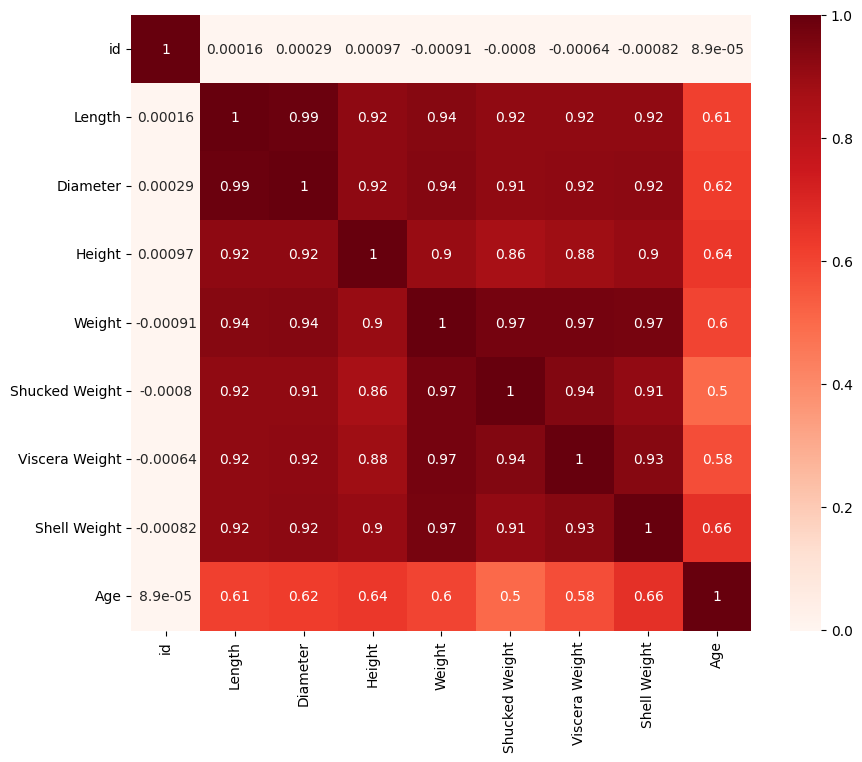

In [14]:
plt.figure(figsize=(10,8))
sns.heatmap(train_data.drop('Sex',axis=1).corr(),cmap = "Reds", annot=True,)

<Axes: >

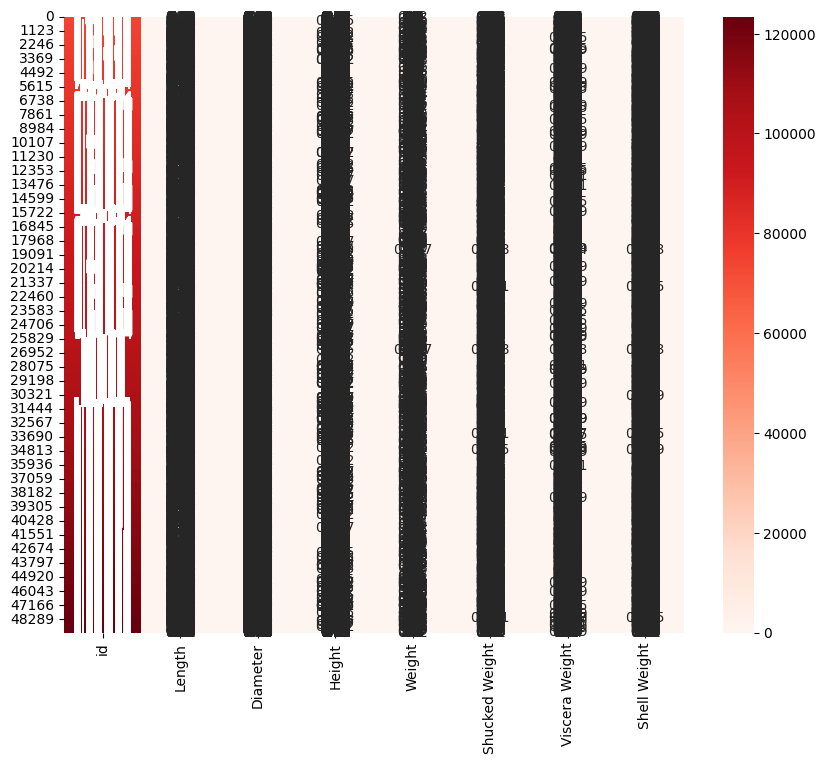

In [15]:
plt.figure(figsize=(10,8))
sns.heatmap(test_data.drop('Sex',axis=1),cmap = "Reds", annot=True)

# Data Modelling

1) Fine-tune XGBoost, LightGBM and CatBoost
2) Stack XGBoost, LightGBM and CatBoost
3) Compute Median of output from three models and round up

In [19]:
def evaluate_model_with_stack(X, y, model1,model2,model3, num_folds=10, n_repeats=5, random_state=1):
    kf = RepeatedKFold(n_splits=num_folds, n_repeats=n_repeats, random_state=random_state)
    maes = []
    
    for train_index, val_index in kf.split(X, y):
        global stacked_predictions
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        model1.fit(X_train, y_train)
        y_pred1 = model1.predict(X_val)
        
        model2.fit(X_train, y_train)
        y_pred2 = model2.predict(X_val)
        
        model3.fit(X_train, y_train)
        y_pred3 = model3.predict(X_val)
        
        X_stack = np.column_stack((y_pred1, y_pred2, y_pred3))
        stacked_predictions = np.round(np.median(X_stack, axis=1))

        mae = mean_absolute_error(y_val, stacked_predictions)
        maes.append(mae)

    mean_mae = np.mean(maes)
    return mean_mae


data = pd.get_dummies(train_data.drop(['id'],axis=1).drop_duplicates(),drop_first=True, dtype='int32')
data['Height'] = data['Height'].replace('0.0','0.0125')
X = data.drop('Age',axis=1)
y = data['Age']

# Evaluate the model
xgb_model = xgb.XGBRegressor(objective='reg:absoluteerror',learning_rate=0.1, max_depth=7, min_child_weight=3, n_estimators=200, subsample=0.7, gamma=0.1, reg_lambda=0, reg_alpha=0)
lgb_model = lightgbm.LGBMRegressor(max_depth=5,num_leaves=120, n_estimators=1800,objective='mae', metric='mean_absolute_error',reg_alpha=0.000012, reg_lambda=0.45)
catboost_model = CatBoostRegressor(loss_function='MAE',eval_metric='MAE',bagging_temperature=2.5, colsample_bylevel=0.75,learning_rate=0.067,od_wait=40,max_depth=6,l2_leaf_reg=1.575,min_data_in_leaf=28,random_strength=0.55, max_bin=256, logging_level='Silent')


score = evaluate_model_with_stack(X,y, xgb_model, lgb_model, catboost_model)
print("Average MAE after Stacking: ",score)

Average MAE after Stacking:  1.3386856250830803


In [29]:
# Yeni tahminler için stacking modelini train verileri üzerinde eğitin
xgb_model.fit(X, y)
lgb_model.fit(X, y)
catboost_model.fit(X, y)

# Test verilerini kullanarak tahminler yapın
test_data_encoded = pd.get_dummies(test_data.drop('id', axis=1).drop_duplicates(), drop_first=True, dtype='int32')
test_data_encoded['Height'] = test_data_encoded['Height'].replace('0.0', '0.0125')
X_test = test_data_encoded  # Test verileri

y_pred1 = xgb_model.predict(X_test)
y_pred2 = lgb_model.predict(X_test)
y_pred3 = catboost_model.predict(X_test)

X_stack_test = np.column_stack((y_pred1, y_pred2, y_pred3))
stacked_predictions_test = np.round(np.median(X_stack_test, axis=1))

# Tahminlerinizi kullanarak yeni bir DataFrame oluşturun
predictions_df = pd.DataFrame({'id': test_data['id'], 'Age': stacked_predictions_test})

# Yeni tahminleri görüntüleyin
predictions_df

,id,Age
0,74051,7.0
1,74052,8.0
2,74053,10.0
3,74054,9.0
4,74055,7.0
...,...,...
49363,123414,9.0
49364,123415,8.0
49365,123416,13.0
49366,123417,9.0


In [31]:
predictions_df.to_csv('simple_submission.csv' , index = None)

# Future Work

1) Feature Engineering- Compute the feature and perform the analysis again

1.1 Volume: Calculate the volume of the crab using the length, diameter, and height. The formula for calculating the volume of a cylindrical object (approximating the shape of a crab) is V = π (Diameter/2)^2 Height. This derived feature takes into account the overall size and shape of the crab.

1.2 Density: Calculate the density of the crab by dividing the weight by the volume. Density can provide insights into the crab's growth and development.

1.3 Shell-to-Body Ratio: Calculate the ratio of shell weight to the total weight of the crab (weight + shell weight). This ratio can indicate the proportion of the crab's weight that is attributed to the shell, which may have implications for its age and development.

1.4 Meat-Yield: Calculate the ratio of shucked weight (weight without the shell) to the total weight of the crab. This feature represents the proportion of edible meat relative to the total weight and can be relevant for commercial fishing or aquaculture contexts.

1.5 Body-Condition-Index: Create a composite feature that combines length, weight, and shucked weight. For example, you can calculate the square root of the product of length, weight, and shucked weight. This index may provide an indication of the crab's overall health and condition.

2) Modelling

2.1 Implmenting voting regressor

2.2 Attempt NN model

3) Focus on quasi duplicate data treamtment

In [ ]:
# Done.